# Problem Set II

## Part 1: Simulation with Metropolis-Hastings and Comparison

*Task*: Simulate a normal (Gaussian) distribution using the Metropolis-Hastings algorithm, targeting a mean ($\mu$) of 0 and variance ($\sigma^2$) of 1.

*Approach*: Implement the Metropolis-Hastings algorithm within the framework provided by the `Elvis_simple.jl` file. 

- *Acceptance Criterion*: Define the acceptance criterion based on the ratio of the target distribution probabilities and the proposal distribution probabilities.

## Solution

The Metropolis-Hastings algorithm performs a sampling from a target distribution $\pi$ by generating a Markov chain with a stationary distribution of $\pi$. 

My solution is based on a proposal distribution with mean 0 and variance 1.5, as seen below. I run the solution 10,000 times. 

### Defining the proposal distribution

The code in Julia below defines the proposal distribution based on a normal distribution with mean 0 and variance 2. 

In [28]:
using Distributions
using Random
using DataFrames

function metropolis_hastings(n_samples::Int)
    # Initialize the chain
    chain = zeros(n_samples)
    current = randn()  # Start at a random place

    # Target distribution
    target = Normal(0, 1.5)

    for i in 2:n_samples
        proposal = current + randn()  # Add some noise

        # Calculate acceptance probability
        p_accept = min(1, pdf(target, proposal) / pdf(target, current))

        # Accept or reject
        if rand() < p_accept
            current = proposal
        end

        chain[i] = current
    end

    return chain
end

# Generate 100,000 samples

samples = metropolis_hastings(100000)

# Make it a dataframe

samples_df = DataFrame(x= samples)

Row,x
,Float64
1,0.0
2,0.307162
3,-1.45251
4,-1.45251
5,-0.754818
6,-2.49602
7,-1.85637
8,0.281805
9,0.00660573


I plot the proposal distribution below to see how "normal" it looks. I use `TidierPlots`, the amazing Julia implementation of R's *ggplot2*. I also overlay a standard normal distribution (`randn()`) to compare the two, where the standard normal distribution is the darker distribution overlaid in the histogram below. 


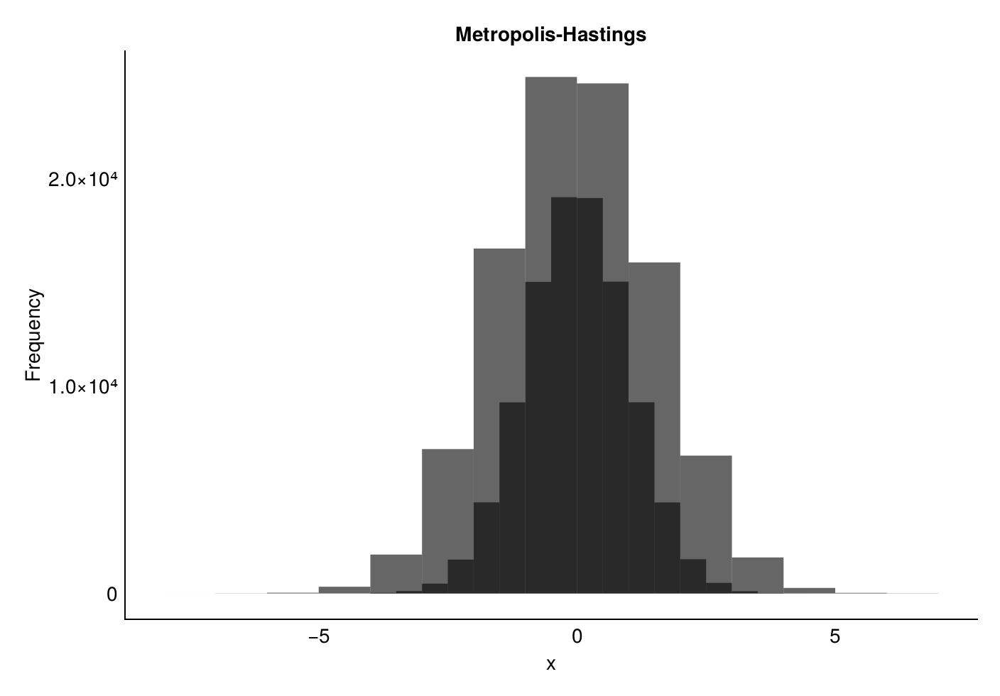

ggplot options

height: 400
x: x
title: Metropolis-Hastings
width: 600
y: Frequency

geom_histogram
data: inherits from plot
x: not specified 

geom_histogram
data: A DataFrame (100000 rows, 1 columns)
x: 

normal 



In [29]:
using Tidier

standard_normal = DataFrame(normal = randn(100000))

ggplot(samples_df, aes(x=:x)) + 
    geom_histogram(binwidth=0.1) + 
    geom_histogram(data = standard_normal, aes(x = :normal)) +
    labs(title="Metropolis-Hastings", x="x", y="Frequency") +
    theme_minimal()

The data looks pretty normal, however, it can noted that my sample has wider tails, probably due to the greater variance. Below, I also computed descriptive statistics using `TidierData`, the Julia implementation of R's `dplyr`.

In [30]:
@chain samples_df begin
    @summarise(mean = mean(skipmissing(x)),
               std = std(skipmissing(x)))
end

Row,mean,std
,Float64,Float64
1,-0.0287517,1.49015


The mean is approximately 0, and the standard deviation is approximately 1.5, which are close to the target distribution's $\pi$ defined mean and standard deviation, so the Metropolis-Hastings algorithm is working well in this regard. A Q-Q plot is presented below to see how well it fits a normal distribution. 

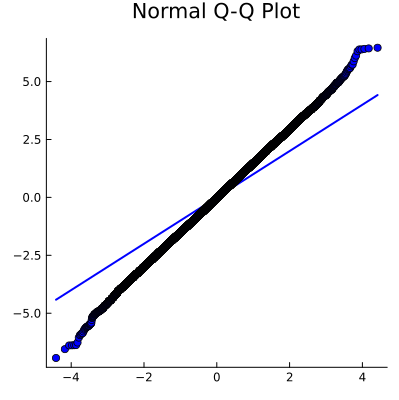

In [31]:
using StatsPlots

qqplot(Normal(), samples, title="Normal Q-Q Plot", legend=false, color=:blue, lw=2, grid=false, size=(400, 400))

The data has heavier tails than a normal distribution, but it is still a good approximation. As mentioned the heavier tails probably come from the variance of 1.5 in the target distribution $\pi$.